# Compaction Modelling using a probabilistic compaction model





### Patrick Makuluni  and Juerg Hauser
CSIRO Black Mountain, Canberra ACT

email:patrick.makuluni@csiro.au



## Background

Uplift and exhumation studies within Australian sedimentary basins use empirical compaction models and equations that were developed using data from international (non-Australian) Basins, for example, American and European sedimentary basins ([Allen & Allen, 2013](https://www.wiley.com/en-au/Basin+Analysis:+Principles+and+Application+to+Petroleum+Play+Assessment,+3rd+Edition-p-9780470673775)). 

Geological datasets have unique features inherited from the geological evolution history of the region; hence algorithms developed from such data may have some limitations when applied in entirely different regions. Additionally, most exhumation estimation methods lack robust uncertainty quantification, thereby inciting lengthy debates on how accurate and acceptable the exhumation results reported by different authors are ([Corcoran & Doré, 2005](https://doi.org/10.1016/j.earscirev.2005.05.003)).

Here we are developing an equation for quantifying exhumation using Bayesian methods on sonic log data from an Australian Sedimentary Basin, the Northern Carnarvon Basin. 

In [24]:
# Import the required modules
import numpy as np
import matplotlib.pyplot as plt
import scipy
import scipy.optimize
import math
import pandas as pd
import os
import arviz as az
from cofi import BaseProblem, InversionOptions, Inversion
from PIL import Image
from matplotlib import image
np.random.seed(42)

**The Normal Compaction Curve**

The general procedure of estimating exhumation follows two major steps: Firstly, create the porosity-depth reference curve for a specific rock unit using data from normally buried and unexhumed sedimentary sections ( [Corcoran & Doré, 2005](https://doi.org/10.1016/j.earscirev.2005.05.003); [Makuluni et al., 2022](https://doi.org/10.1016/j.marpetgeo.2021.105318)). The second stage uses the numerical compaction model developed in the first stage to estimate exhumation magnitudes and their associated uncertainties in exhumed parts of sedimentary basins.  

An accurate and reliable reference curve must be established using a large porosity dataset (or sonic transit) over significantly wide depth ranges and from sedimentary units that are currently at a maximum burial depth. This reference curve serves as a regional compaction model from which we can develop a data-driven numerical porosity-depth model that best fits and accurately represents this reference curve. 


This numerical model estimates the depth ranges of normally compacted and unexhumed lithological units, given their porosity or sonic trasit time data.
We build this reference curve also termed the normal compaction trend (NCT) using sonic interval travel time (Δt) and depth data from unexhumed shale units from the Beagle, Dampier and Barrow  sub-basins of the Northern Carnarvon Basin. 


**Map of the Study Region and Well Data locations**

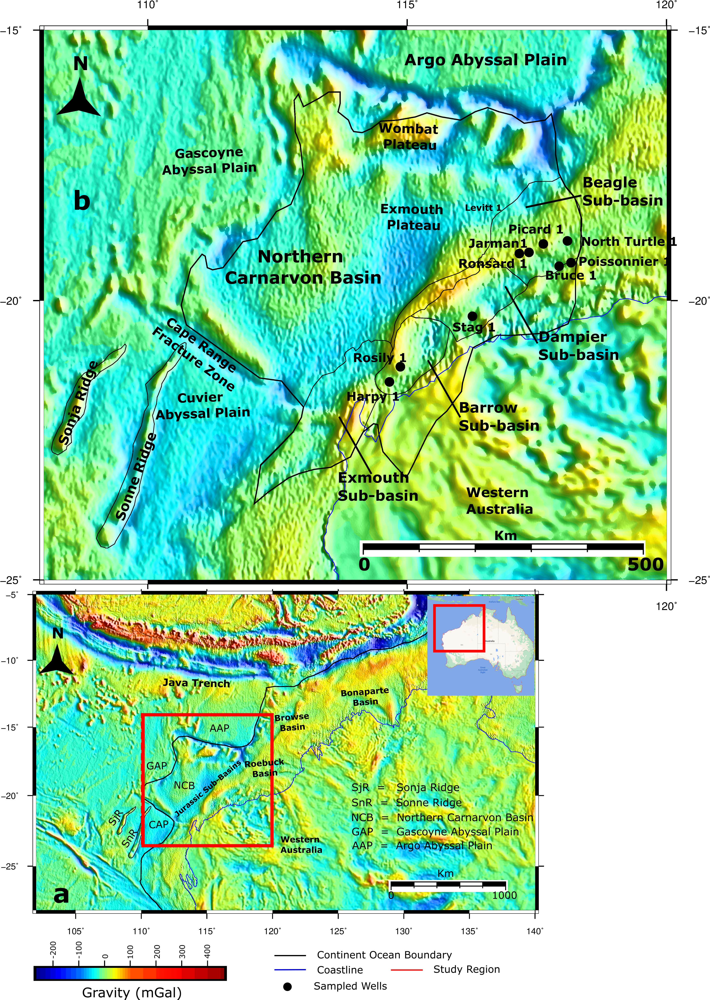

In [25]:
Image.open("Compaction Regional Fig.png", mode='r', formats=None)

The preceeding figure shows the Free-air gravity anomaly ([Sandwell et al., 2014](http://www.sciencemag.org/lookup/doi/10.1126/science.1258213)), highlighting the structural setting of the Australian North West Shelf and its basins bounded by the Java trench on the northern margin, Abyssal Plains on the western margin. The insert shows the study region, the Northern Carnarvon Basin, and its tectonic blocks, sitting on the southern end of the North West Shelf, surrounded by Argo, Gascoyne, and Cuvier abyssal plains. The top image shows the distribution of wells from where we compiled the sonic log data that we import in the next step.

In [26]:
compaction_data = pd.read_csv('compaction Data.csv')
compaction_data = compaction_data.values
compaction_data = np.transpose(compaction_data)
sonic = compaction_data[1,:]
depth = compaction_data[0,:]

**Normal Compaction Curve from Theory**

Let us check the suitability of the dataset for creating the Normal Compaction Curve of the North West Shelf. To do this we plot the data together with the theoretical curve from literature ([Corcoran & Doré, 2005](https://doi.org/10.1016/j.earscirev.2005.05.003)).   

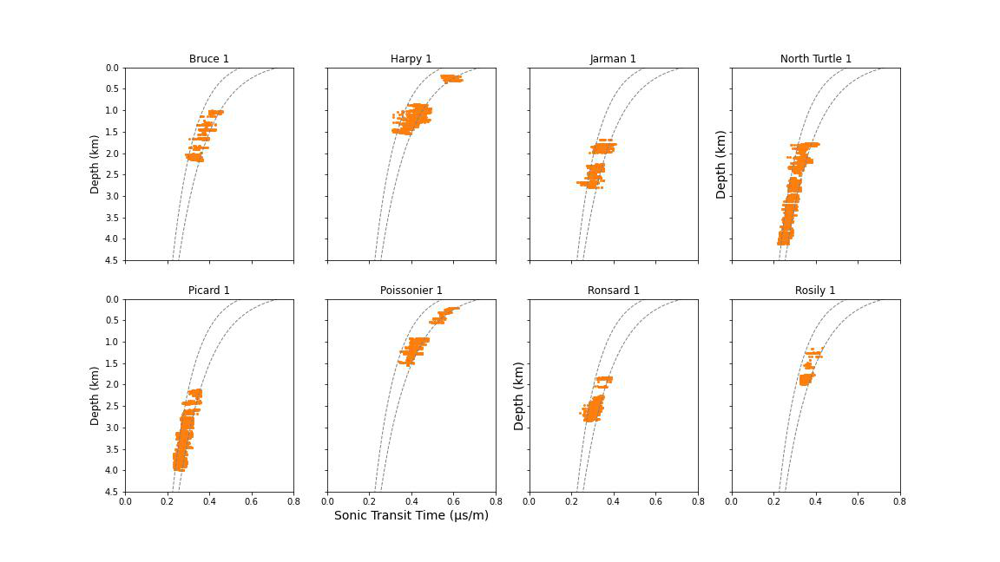

In [27]:
Image.open("Well Data.jpg", mode='r', formats=None)

**The upper and lower bounds of the theoretical NCT**

The upper and lower bounds for the compaction curves are given by the following equations taken from the literature 

upper boundary:       $y = 40e^{-9.445x} - 0.22$

Lower boundary:        $y = 27.629e^{-6.976x} - 0.17$

In [28]:
range_x = np.linspace(0.2, 0.8, num=500) # theoretical range of sonic transit time 
true_y = 30*np.exp(-8*range_x)-0.19 # midpoint of the theoretical NCT 

upper_y1 = 40*np.exp(-9.445*range_x)-0.22 # upper boundary of the theoretical normal comapction region Magara (1976)
lower_y2 = 27.629*np.exp(-6.976*range_x)-0.17  # lower boundary of the theoretical normal comapction region Magara (1976)

## Problem definition

In the following code block, we'll define the forward function that fits the the data (observations) from the wells in the previous figure.

### The Equation to be fitted

From literature review and simple regression, we suggest that the data can be fitted by an exponential equation of the following nature:

$y = ae^{-bx} - c$

Now our aim is to estimate the values of parameters a, b, and c using the sonic transit time (x) and depth (y) data

In [29]:
def compaction(m,x):
    return m[0]*np.exp(-m[1]*x)-m[2]

def get_residuals(m,x,y):    
    model = compaction(m,x)
    return model-y

### Choose an intial guess for our parameters

In [30]:
# Choose an initial guess for our parameters.
a_initial=30
b_initial=8
c_initial=0.5
f_initial = 0.125

m_initial= [a_initial,b_initial,c_initial,f_initial]

#### Combined plot

- Now let's plot all the wells on a single graph to visualise the data distribution 
- Plot the model using the intial guess for our  parameters

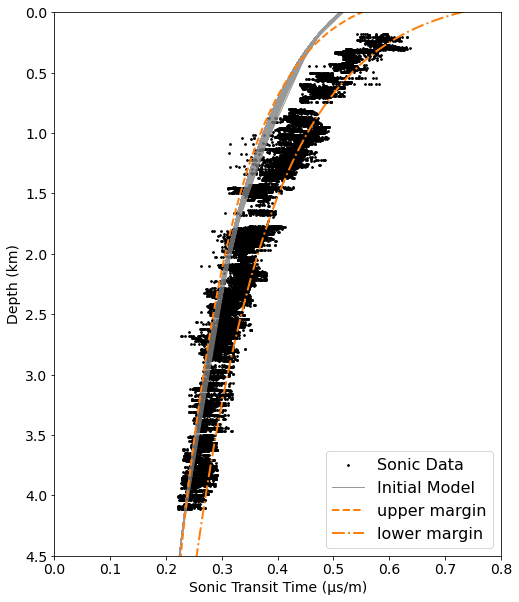

In [31]:
x = sonic
y = depth
fig, axes = plt.subplots(figsize =[8, 10])
axes.scatter(x,y, color = 'k', label="Sonic Data", s=12, marker = '.')
axes.plot(x, compaction(m_initial,x), "gray", alpha=0.8, lw=1, label="Initial Model")
axes.plot(range_x, upper_y1, color = 'C1', linewidth=2, label="upper margin", linestyle='dashed')
axes.plot(range_x, lower_y2, color = 'C1', linewidth=2, label="lower margin", linestyle='dashdot')
plt.xlim(0, 1)
plt.ylim(4.5, 0)
plt.xlabel("x")
plt.ylabel("y")

plt.legend(fontsize=16, loc ="lower right")
plt.xticks(fontsize= 14 )
plt.yticks(fontsize= 14 )
#plt.grid(True)
plt.xlim(0, 0.8)
plt.ylim(4.5, 0)
plt.xlabel("Sonic Transit Time (µs/m)", fontsize = '14')
plt.ylabel("Depth (km)", fontsize = '14')
plt.savefig("Combined Sonic Data.jpg")


### Prior distribution and log likelihood

To use a Bayesian approach for enxemble estimation we need to define a log likelihood and prior pobability similary paremeater estimation an objectie function and here we will use the negative log likelihood. We assume that the noise on the data is unknonw and introduce an additional model parameter $\sigma$

In [32]:
def log_prior(m):    # uniform distribution
    if 0 < m[0] < 30 and 0 < m[1] < 20 and  0 < m[2] < 10 and  0.0001 < m[3] < 0.5:
        return 0.0
    return -np.inf

def log_likelihood(m, x, y):
    model = compaction(m,x)
    sigma2 =  m[3]**2
    return -0.5 * np.sum((y - model) ** 2 / sigma2 + np.log(sigma2))

def negative_log_likelihood(m,x,y):
    return -log_likelihood(m,x,y)

## Parameter estimation using `scipy.optimize.minimize`

Using the negative log likelihood we can employ paramter estimation using `scipy.optimise minimise`.

In [33]:
from scipy.optimize import minimize

np.random.seed(42)
nll = lambda *args: -log_likelihood(*args)
initial = np.array([a_initial, b_initial, c_initial, f_initial]) + 0.5 * np.random.randn(4)
soln = minimize(nll, initial, args=(x, y))
print(soln.x[0],soln.x[1],soln.x[2],soln.x[3])


17.61283827459531 5.910385743251474 0.3125737822936884 0.2515868853254303


The same is possible directly via CoFI

In [34]:
######## CoFI BaseProblem - provide additional information
inv_problem = BaseProblem()
inv_problem.name = "Curve Fitting"
inv_problem.set_data(y)
inv_problem.set_forward(compaction, args=[x])
inv_problem.set_objective(negative_log_likelihood,args=[x,y]) 
inv_problem.set_initial_model([a_initial, b_initial, c_initial, f_initial])

######## CoFI InversionOptions - set a different tool
inv_options = InversionOptions()
inv_options.set_tool("scipy.optimize.minimize")
inv_options.set_params(method="Nelder-Mead")

######## CoFI Inversion - run it
inv = Inversion(inv_problem, inv_options)
inv_result = inv.run()

######## CoFI InversionResult - check result
print(f"The inversion result from `scipy.optimize.minimize`: {inv_result.model}\n")
inv_result.summary()

The inversion result from `scipy.optimize.minimize`: [17.61285975  5.91039519  0.31257039  0.25158665]

Summary for inversion result
SUCCESS
----------------------------
fun: -23030.492374818805
nit: 287
nfev: 482
status: 0
message: Optimization terminated successfully.
final_simplex: (array([[17.61285975,  5.91039519,  0.31257039,  0.25158665],
       [17.61291055,  5.9104096 ,  0.31256442,  0.25158679],
       [17.61280549,  5.9103742 ,  0.31257886,  0.25158607],
       [17.61277483,  5.91037107,  0.31257567,  0.2515877 ],
       [17.61283198,  5.91039303,  0.31256679,  0.25158636]]), array([-23030.49237482, -23030.49237481, -23030.49237466, -23030.49237437,
       -23030.49237433]))
model: [17.61285975  5.91039519  0.31257039  0.25158665]


## Ensemble estimation using emcee

Having the problem defined in CoFI we can also use the emcee affine-invariant ensemble sampler for the Markov chain Monte Carlo (MCMC) to marginalise the compaction model parameters [Foreman-Mackey et al. (2013)](http://iopscience.iop.org/article/10.1086/670067)

### Hyperparameters

We need to define the number of walkers and initialise the starting positions of walkers. We start all walkers in a small ball about a chosen point, here the solution found via optimisation.

In [35]:
nwalkers = 32
ndim = 4
nsteps = 10000
#use the scipy minimise solution as a walkers starting point
walkers_start = np.array([soln.x[0],soln.x[1],soln.x[2],soln.x[3]]) + 1e-4 * np.random.randn(nwalkers, ndim)

In the following we now define  problem in CoFI using some of the functions defined previously. We being by creating a `BaseProblem` and setting the InversionOptions to use `emcee`.


In [36]:
inv_problem = BaseProblem()
inv_options = InversionOptions()

Finally, we attach the information to our BaseProblem and InversionOptions objects.

In [37]:
######## Provide additional information
inv_problem.set_log_prior(log_prior)
inv_problem.set_log_likelihood(log_likelihood,args=[x,y])
inv_problem.set_model_shape(ndim)

######## Set a different tool
inv_options = InversionOptions()
inv_options.set_tool("emcee")
inv_options.set_params(nwalkers=nwalkers, nsteps=nsteps, initial_state=walkers_start)

######## Run it
inv = Inversion(inv_problem, inv_options)
inv_result = inv.run()

######## Check result
print(f"The inversion result from `emcee`:")
inv_result.summary()

The inversion result from `emcee`:
Summary for inversion result
SUCCESS
----------------------------
sampler: <emcee.ensemble.EnsembleSampler object>
blob_names: ['log_likelihood', 'log_prior']


### Analyse sampling results

After any sampling it is advisable to check the results and assess if there has been enough walkers or enough samplers. We can access all the raw data directly by exploring this inv_result_3.sampler object. Additionally, we can convert a sampler object into an instance of arviz.InferenceData, to expose all the plotting functions from arviz.

[Reference](https://python.arviz.org/en/latest/api/generated/arviz.InferenceData.html#arviz.InferenceData) 

In [38]:
sampler = inv_result.sampler
az_idata = inv_result.to_arviz()

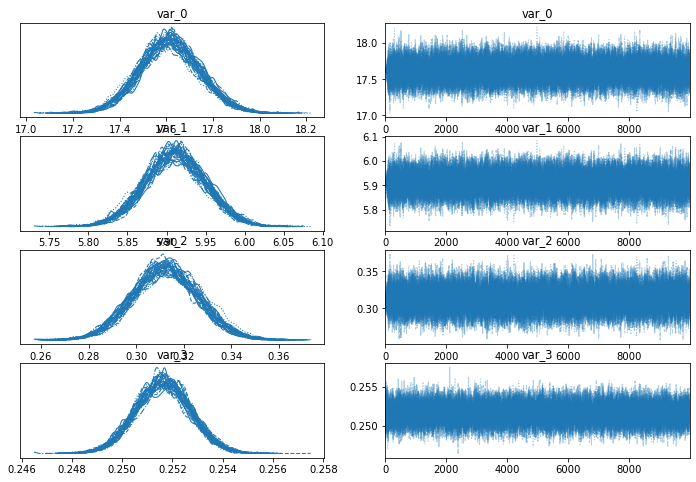

In [39]:
labels = ["m0", "m1", "m2", "m3"]
az.plot_trace(az_idata);

plt.savefig("trace.jpg")

#### Autocorrelation analysis

In [40]:
tau = sampler.get_autocorr_time()
print(f"autocorrelation time: {tau}")

autocorrelation time: [47.5910463  47.34824192 46.99439533 47.14566576]


#### Corner plot

The autocorrelation time above suggests that only about 50 steps are needed for the chain to “forget” where it started. Lets throw away a few times this number of steps as “burn-in” [Foreman-Mackey et al. (2013)](http://iopscience.iop.org/article/10.1086/670067).

Therefore prior to making a corne plot we discard the initial 300 steps (burn-in), and thin by about half the autocorrelation time (30 steps).


In [41]:
flat_samples = sampler.get_chain(discard=300, thin=30, flat=True)
print(flat_samples.shape)

(10336, 4)


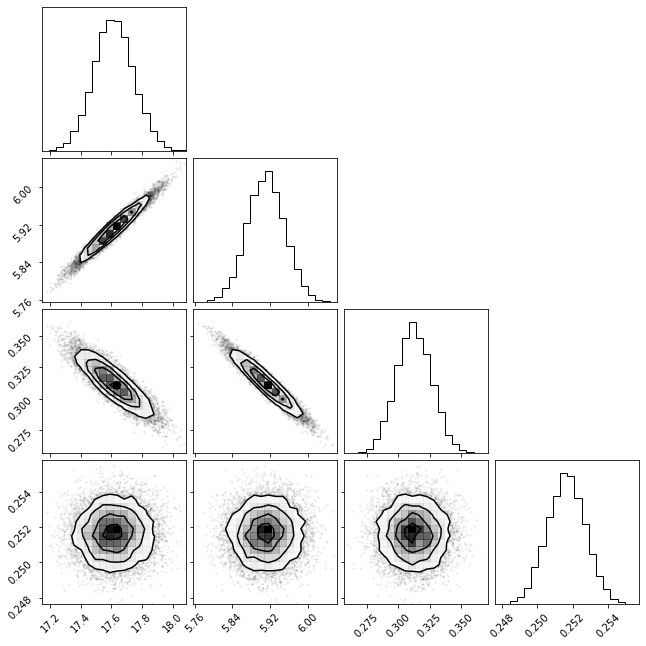

In [42]:
import corner

fig = corner.corner(flat_samples)

plt.savefig("parameter Corner.jpg")

The corner plot shows all the one and two dimensional projections of the posterior probability distributions of the parameters. This demonstrates all of the covariances between parameters. The corner plot shows the marginalized distribution for each parameter independently in the histograms along the diagonal and then the marginalized two dimensional distributions in the other panels.

Finally, we can plot the set of models that fit the data together with the data and thereby get an udnerstanding of the uncertainty in our model. 

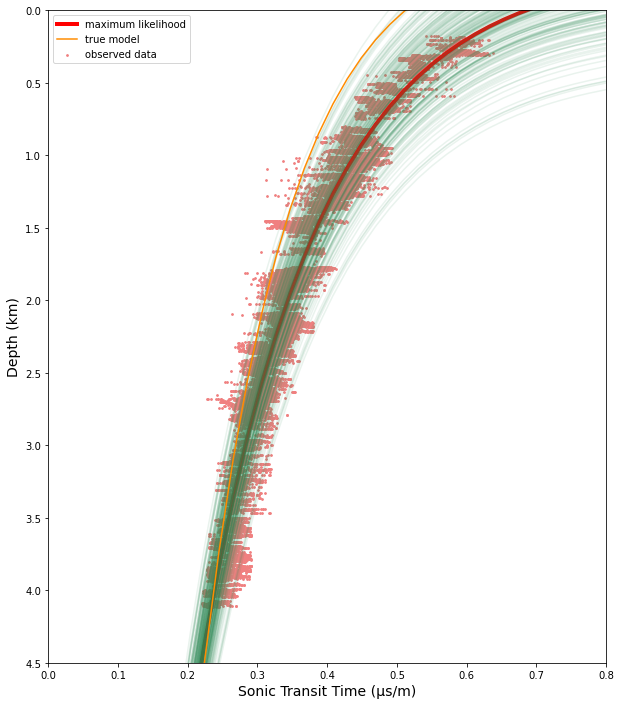

In [45]:
flat_samples = sampler.get_chain(discard=300, thin=100, flat=True)
inds = np.random.randint(len(flat_samples), size=200) # get a random selection from posterior ensemble
_x_plot = np.linspace(0,1.0)
_y_plot =  compaction(m_initial,_x_plot)
plt.figure(figsize=(10,12))
sample = flat_samples[0]
_y_synth =  compaction(sample,_x_plot)
plt.plot(_x_plot, _y_synth, color="red", label="maximum likelihood",alpha=1, lw=4)
for ind in inds:
    sample = flat_samples[ind]
    _y_synth =  compaction(sample,_x_plot)
    _y_synth +=sample[3]*np.random.randn(1)
    plt.plot(_x_plot, _y_synth, color="seagreen", alpha=0.1)
plt.plot(_x_plot, _y_plot, color="darkorange", label="true model")
plt.scatter(x, y, color="lightcoral", label="observed data", s=12, marker = '.')
plt.xlim(0, 0.8)
plt.ylim(4.5,0)
plt.xlabel("Sonic Transit Time (µs/m)", fontsize = '14')
plt.ylabel("Depth (km)", fontsize = '14')
plt.legend();

plt.savefig("noise propagation.jpg")

**Uncertainty estimates**

We can now calculate some formal uncertainties for our model aparameters $a$, $b$, $c$ and $d$ based on the 16th, 50th, and 84th percentiles of the samples in the marginalized distributions.

In [47]:
solution = np.zeros(4)
for i in range(ndim):
    mcmc = np.percentile(flat_samples[:, i], [16, 50, 84])
    solution[i] = mcmc[1]
    q = np.diff(mcmc)
    print(f"{labels[i]} = {round(mcmc[1],3)}, (-{round(q[0],3)}, +{round(q[1],3)})")

m0 = 17.617, (-0.13, +0.13)
m1 = 5.912, (-0.04, +0.039)
m2 = 0.312, (-0.014, +0.014)
m3 = 0.252, (-0.001, +0.001)
